In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pymc3 as pm
import theano.tensor as tt

from theano.compile.ops import as_op
from scipy.stats import norm
from matplotlib import gridspec
from matplotlib.patches import Rectangle
from IPython.display import Image
import seaborn as sns
import pymc3 as pm
import numpy as np
from scipy.stats import norm
import pandas as pd

import theano.tensor as T
from theano.compile.ops import as_op

%matplotlib inline
plt.style.use('seaborn-white')

color = '#87ceeb'

f_dict = {'size':14}

WARNING (theano.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


In [2]:
df2 = pd.read_csv('../data/pseudonymized-data.csv', dtype={'Community':'category',
                                  'V27':'category',
                                  'V28':'category',
                                  'V29':'category',
                                  'V30':'category',
                                  'V31':'category',
                                  'V32':'category',
                                  'V33':'category'})
df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 387 entries, 0 to 386
Data columns (total 8 columns):
 #   Column     Non-Null Count  Dtype   
---  ------     --------------  -----   
 0   Community  387 non-null    category
 1   V27        387 non-null    category
 2   V28        387 non-null    category
 3   V29        387 non-null    category
 4   V30        387 non-null    category
 5   V31        387 non-null    category
 6   V32        387 non-null    category
 7   V33        387 non-null    category
dtypes: category(8)
memory usage: 5.3 KB


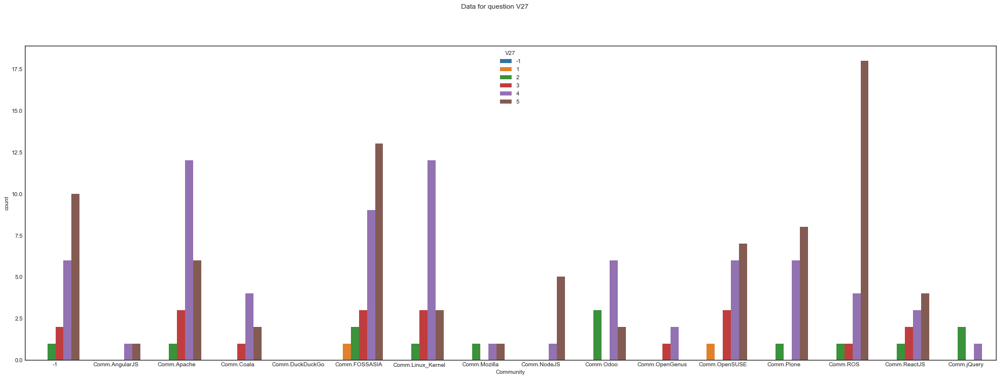

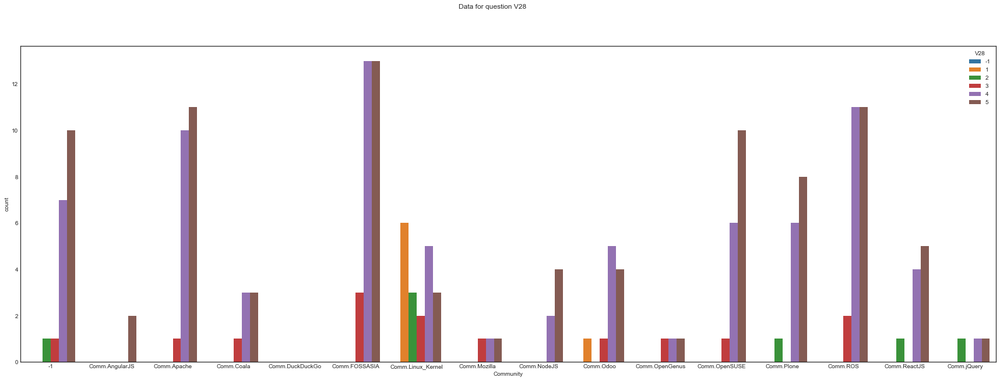

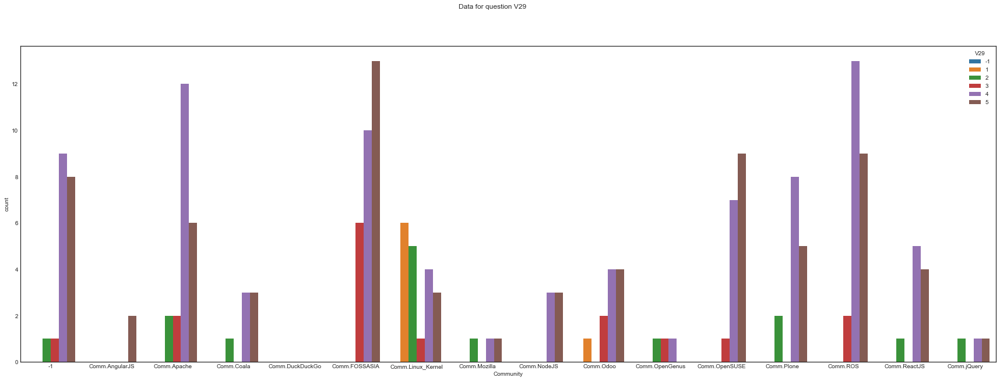

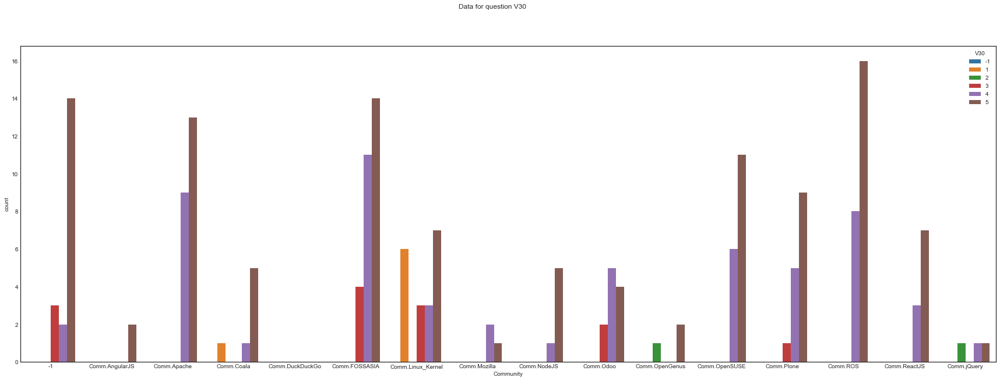

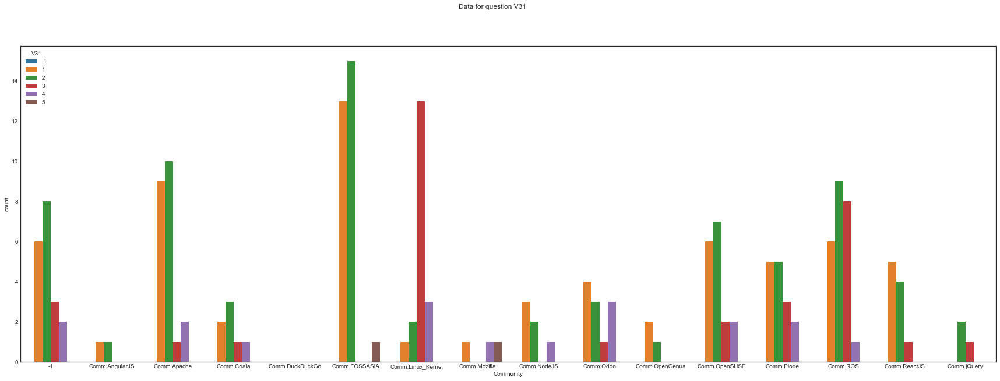

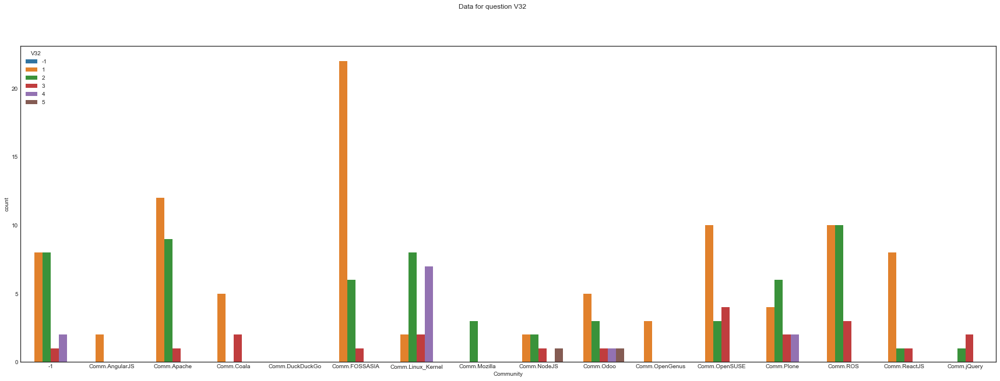

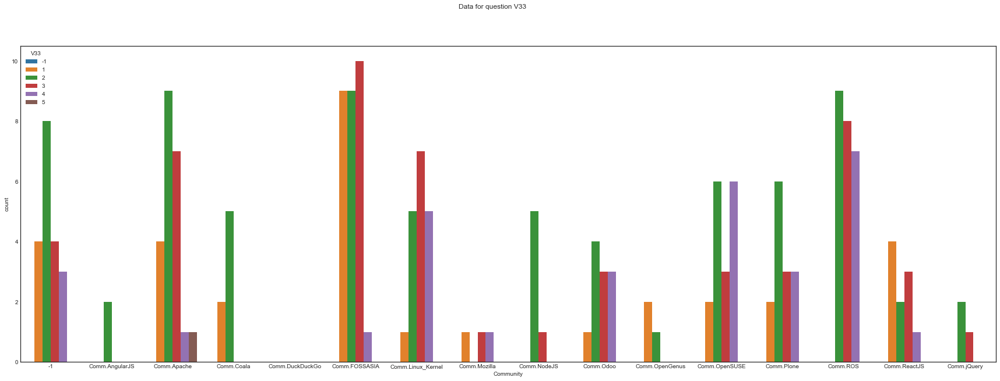

[None, None, None, None, None, None, None]

In [4]:
def plot_count(q):
    plt.figure(figsize=(30,10))
    sns.countplot(x=df2[df2[q]!='-1'].Community,hue=df2[df2[q]!='-1'][q])
    plt.suptitle('Data for question '+q)
    plt.show()
[plot_count(q) for q in ['V27','V28','V29','V30','V31','V32','V33']]

In [5]:
# Some auxiliary functions

# reduce data values by 1 so that they become indexes for the cdf array below.
# the .cat.codes function from pandas doesn't work because it assings codes depending on the different values of the data
def from_data_to_code(x):
    return int(x)-1
def codes(self):
    return np.array([from_data_to_code(x) for x in self])

In [6]:
def infer(q):
    # Number of outcomes
    nYlevels2 = 5 # df2.V28.cat.categories.size
    # Number of groups
    n_grps = df2.Community.nunique()
    # Group index
    grp_idx = df2[df2[q]!='-1'].Community.cat.codes.values

    thresh2 = np.arange(1.5, nYlevels2, dtype=np.float64)
    thresh_obs2 = np.ma.asarray(thresh2)
    thresh_obs2[1:-1] = np.ma.masked

    print('thresh2:\t{}'.format(thresh2))
    print('thresh_obs2:\t{}'.format(thresh_obs2))


    @as_op(itypes=[tt.dvector, tt.dvector, tt.dvector], otypes=[tt.dmatrix])
    def outcome_probabilities(theta, mu, sigma):
        out = np.empty((nYlevels2, n_grps), dtype=np.float64)
        n = norm(loc=mu, scale=sigma)       
        out[0,:] = n.cdf(theta[0])        
        out[1,:] = np.max([np.repeat(0,n_grps), n.cdf(theta[1]) - n.cdf(theta[0])], axis=0)
        out[2,:] = np.max([np.repeat(0,n_grps), n.cdf(theta[2]) - n.cdf(theta[1])], axis=0)
        out[3,:] = np.max([np.repeat(0,n_grps), n.cdf(theta[3]) - n.cdf(theta[2])], axis=0)
        out[4,:] = 1 - n.cdf(theta[3])
        return out

    with pm.Model() as ordinal_model_multi_groups:    
        
        theta = pm.Normal('theta', mu=thresh2, tau=np.repeat(.5**2, len(thresh2)),
                          shape=len(thresh2), observed=thresh_obs2)
        
        mu = pm.Normal('mu', mu=nYlevels2/2.0, tau=1.0/(nYlevels2**2), shape=n_grps)
        sigma = pm.Uniform('sigma', nYlevels2/1000.0, nYlevels2*10.0, shape=n_grps)
        
        pr = outcome_probabilities(theta, mu, sigma)
        
        y = pm.Categorical('y', pr[:,grp_idx].T, observed=codes(df2[df2[q]!='-1'][q]))    #df2.V28.cat.codes.to_numpy())
    
        trace2 = pm.sample(5000, tune=1000, cores=4)
    
        return trace2

In [10]:
with ordinal_model_multi_groups:
    trace2 = pm.sample(5000, tune=1000, cores=4)

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Initializing NUTS failed. Falling back to elementwise auto-assignment.
Multiprocess sampling (4 chains in 4 jobs)
CompoundStep
>Slice: [sigma]
>Slice: [mu]
>Slice: [theta_missing]


Sampling 4 chains for 1_000 tune and 5_000 draw iterations (4_000 + 20_000 draws total) took 2599 seconds.
The number of effective samples is smaller than 25% for some parameters.


In [7]:
## Mean density plots of answers to variable v for all communities
def mean_densities(t,v):
    plt.figure(figsize=(15,5))
    NUM_COLORS = 16
    cmap = plt.get_cmap('tab20')
    colors = [cmap(i) for i in np.linspace(0, 1, NUM_COLORS)]
    grp_idxs_colors_grp_names = zip(df2.Community.cat.codes.unique(),colors,df2.Community.unique())
    [pm.plot_kde(t['mu'][:,i], 
                 plot_kwargs={'color': c}, cumulative=False, 
                 label=n) 
      for (i,c,n) in grp_idxs_colors_grp_names]
    plt.xlim([0,7])
    plt.legend(loc='best')
    plt.suptitle('Mean density plots for '+v)
    plt.show()

Text(0.5, 0.98, 'DuckDuckGo question V33')

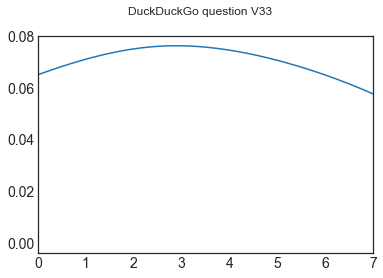

In [228]:
# mean_densities(t,'V33')
pm.plot_kde(t['mu'][:,4])
plt.xlim([0,7])
plt.suptitle('DuckDuckGo question V33')

In [ ]:
mu2 = trace2['mu']
sigma2 = trace2['sigma']

# Concatenate the fixed thresholds into the estimated thresholds
n = trace2['theta_missing'].shape[0]
thresholds2 = np.c_[np.tile([1.5], (n,1)),
                    trace2['theta_missing'],
                    np.tile([4.5], (n,1))]

fig, axes = plt.subplots(5,2, figsize=(10,14))
ax1,ax2,ax3,ax4,ax5,ax6,ax7,ax8,ax9,ax10 = axes.flatten() 

# Mu
pm.plot_posterior(mu2[:,0], point_estimate='mode', color=color, ax=ax1)
ax1.set_xlabel('$\mu_{1}$', fontdict=f_dict)
pm.plot_posterior(mu2[:,1], point_estimate='mode', color=color, ax=ax3)
ax3.set_xlabel('$\mu_{2}$', fontdict=f_dict)
for title, ax in zip(['Comm.Coala Mean', 'Comm.Linux_Kernel Mean'], [ax1, ax3]):
    ax.set_title(title, fontdict=f_dict)

# Sigma
pm.plot_posterior(sigma2[:,0], point_estimate='mode', color=color, ax=ax5)
ax5.set_xlabel('$\sigma_{1}$', fontdict=f_dict)
pm.plot_posterior(sigma2[:,1], point_estimate='mode', color=color, ax=ax7)
ax7.set_xlabel('$\sigma_{2}$', fontdict=f_dict)
for title, ax in zip(['Comm.Coala Std. Dev.', 'Comm.Linux_Kernel Std. Dev.'], [ax5, ax7]):
    ax.set_title(title, fontdict=f_dict)

# Posterior distribution on the thresholds
ax9.scatter(thresholds2, np.tile(thresholds2.mean(axis=1).reshape(-1,1), (1,4)), color=color, alpha=.6, facecolor='none')
ax9.set_ylabel('Mean Threshold', fontdict=f_dict)
ax9.set_xlabel('Threshold', fontdict=f_dict)
ax9.vlines(x = thresholds2.mean(axis=0),
           ymin=thresholds2.mean(axis=1).min(),
           ymax=thresholds2.mean(axis=1).max(), linestyles='dotted', colors=color)

# Posterior predictive probabilities of the outcomes
threshCumProb2A = np.empty(thresholds2.shape)
for i in np.arange(threshCumProb2A.shape[0]):
    threshCumProb2A[i] = norm().cdf((thresholds2[i] - mu2[i,0])/sigma2[i,0])    
outProb2A = (np.c_[threshCumProb2A, np.tile(1, (thresholds2.shape[0],1))]
           - np.c_[np.tile(0, (thresholds2.shape[0],1)), threshCumProb2A])
yerr2A = np.abs(np.subtract(pm.hpd(outProb2A), outProb2A.mean(axis=0).reshape(-1,1)))

ax2.errorbar(x = np.arange(outProb2A.shape[1]), y=outProb2A.mean(axis=0),
             yerr=yerr2A.T, color=color, fmt='o')

threshCumProb2B = np.empty(thresholds2.shape)
for i in np.arange(threshCumProb2B.shape[0]):
    threshCumProb2B[i] = norm().cdf((thresholds2[i] - mu2[i,1])/sigma2[i,1])    
outProb2B = (np.c_[threshCumProb2B, np.tile(1, (thresholds2.shape[0],1))]
           - np.c_[np.tile(0, (thresholds2.shape[0],1)), threshCumProb2B])
yerr2B = np.abs(np.subtract(pm.hpd(outProb2B), outProb2B.mean(axis=0).reshape(-1,1)))

ax4.errorbar(x = np.arange(outProb2B.shape[1]), y=outProb2B.mean(axis=0),
             yerr=yerr2B.T, color=color, fmt='o')

for grp, ax in zip(['Comm.Coala', 'Comm.Linux_Kernel'], [ax2, ax4]):
    ((df2[df2.Community == grp].V28.value_counts().sort_index()/df2[df2.Community == grp].V28.size)
     .plot.bar(ax=ax, rot=0, color='royalblue'))
    ax.set_title('Data for {0} with Post. Pred.\nN = {1}'.format(grp, df2[df2.Community == grp].V28.size), fontdict=f_dict)
    ax.set_xlabel('y')
    sns.despine(ax=ax, left=True)
    ax.yaxis.set_visible(False)

# Mu diff
pm.plot_posterior(mu2[:,1]-mu2[:,0], point_estimate='mode', color=color, ax=ax6)
ax6.set_xlabel('$\mu_{2}-\mu_{1}$', fontdict=f_dict)
# Sigma diff
pm.plot_posterior(sigma2[:,1]-sigma2[:,0], point_estimate='mode', color=color, ax=ax8)
ax8.set_xlabel('$\sigma_{2}-\sigma_{1}$', fontdict=f_dict)
# Effect size
pm.plot_posterior((mu2[:,1]-mu2[:,0]) / np.sqrt((sigma2[:,0]**2+sigma2[:,1]**2)/2), point_estimate='mode', color=color, ax=ax10)
ax10.set_xlabel(r'$\frac{(\mu_2-\mu_1)}{\sqrt{(\sigma_1^2+\sigma_2^2)/2}}$', fontdict=f_dict)
for title, ax in zip(['Differences of Means', 'Difference of Std. Dev\'s', 'Effect Size'], [ax6, ax8, ax10]):
    ax.set_title(title, fontdict=f_dict)

fig.suptitle('V28: I do not consider a pull request/patch, unless I trust the contributor.', fontsize=16)
fig.tight_layout()

In [8]:
def count_per_data_value(d,c,q):
    return np.array([ len(d[(d[q] == x) & (d.Community==c)][q]) for x in ['1','2','3','4','5']])

In [9]:
def comm_to_code(d,c):
    return [code for (comm,code) in zip(d.Community.unique(),d.Community.cat.codes.unique()) if comm==c][0]

In [295]:
comm_to_code(df2,'-1')

0

In [16]:
def plot_ppc_normal_density(d,t,c,q):
    c_code=comm_to_code(d,c)
    x=np.arange(-5,10,step=.01)
    s=pd.Series((count_per_data_value(df2,c,q)/count_per_data_value(df2,c,q).sum()))
    s.index=s.index+1
    s.plot.bar(rot=0, color='royalblue')
    plt.suptitle('Data of '+c+' question '+q)
    [plt.plot(x,norm(loc=m,scale=s).pdf(x),color='lightblue',alpha=.05) 
        for (m,s) in zip(t['mu'][18000:,c_code],t['sigma'][18000:,  c_code])]
    plt.plot(x,norm(loc=np.mean(t['mu'][:,c_code]),scale=np.mean(t['sigma'][:,c_code])).pdf(x),color='blue',linewidth=2)
    plt.xlim([-1,7])
    plt.show()


In [ ]:
# plt.subplot(211)
x_axis = np.arange(-10, 15, 0.01)
(((df2[df2.Community == 'Comm.Linux_Kernel'].V28.value_counts().sort_index()*.4)/df2[df2.Community == 'Comm.Linux_Kernel'].V28.size)
     .plot.bar(rot=0, color='purple'))
[plt.plot(x_axis, norm.pdf(x_axis,m,s),color='royalblue',alpha=.05) for (m,s) in zip(trace2['mu'][18000:,1],trace2['sigma'][18500:,1])]
plt.plot(x_axis, norm.pdf(x_axis,np.mean(trace2['mu'][:,1]),np.mean(trace2['sigma'][:,1])),color='black',linewidth=2)
plt.show()

# plt.subplot(212)
(((df2[df2.Community == 'Comm.Coala'].V28.value_counts().sort_index()*.4)/df2[df2.Community == 'Comm.Coala'].V28.size)
     .plot.bar(rot=0, color='purple'))
[plt.plot(x_axis, norm.pdf(x_axis,m,s),color='royalblue',alpha=.05) for (m,s) in zip(trace2['mu'][18000:,0],trace2['sigma'][18500:,0])]
plt.plot(x_axis, norm.pdf(x_axis,np.mean(trace2['mu'][:,0]),np.mean(trace2['sigma'][:,0])),color='black',linewidth=2)
plt.show()

## Question V28

In this section we explore the results of analyzing question _V28: "I don’t consider a pull
request/patch, unless I trust the contributor"_

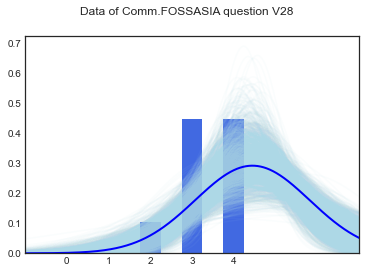

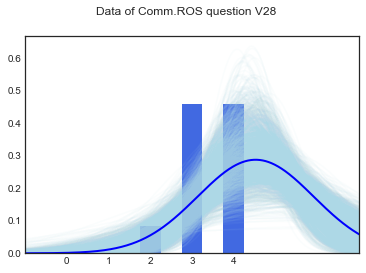

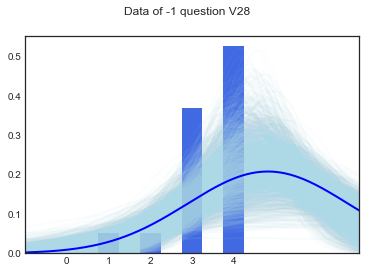

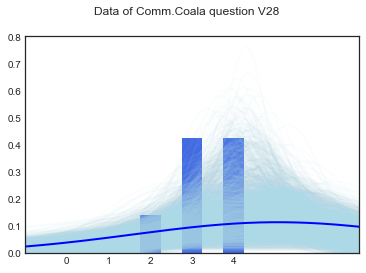

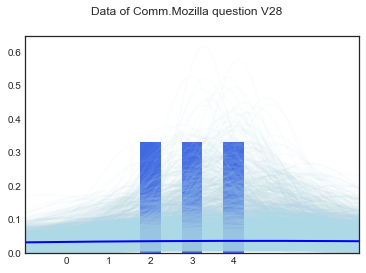

...

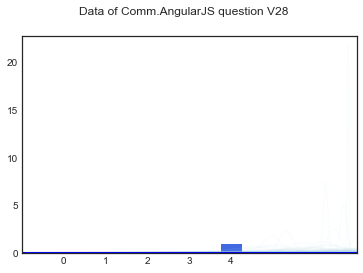

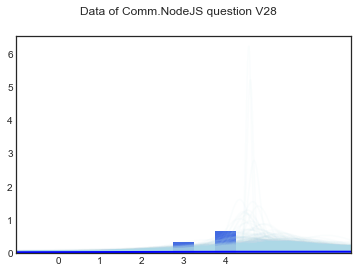

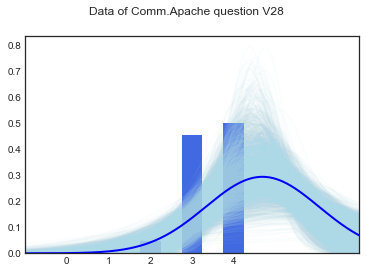

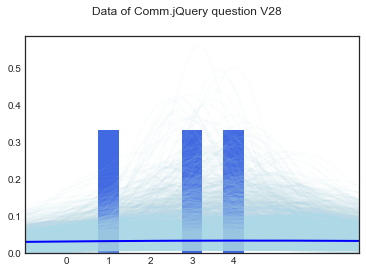

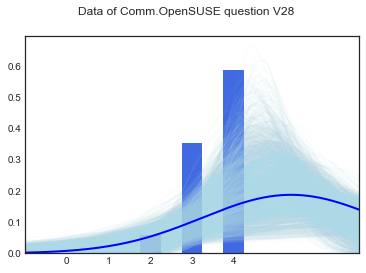

[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

In [303]:
[plot_ppc_normal_density(df2,trace2,c,'V28') for c in df2.Community.unique()]

### Posterior Diagnosis

Below we look at some metrics to determine the quality of our analysis. The ESS and $\hat{R}$ (`r_hat`) values indicate good accuracy.

In [316]:
pm.summary(trace2)

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
theta_missing[0],2.034,0.166,1.734,2.337,0.002,0.002,5982.0,5926.0,6146.0,9077.0,1.0
theta_missing[1],2.725,0.184,2.387,3.074,0.003,0.002,4496.0,4447.0,4524.0,6756.0,1.0
mu[0],4.813,0.634,3.723,6.026,0.007,0.005,9395.0,8718.0,11135.0,8694.0,1.0
mu[1],5.169,4.822,-4.170,14.007,0.041,0.033,13503.0,10773.0,13400.0,12330.0,1.0
mu[2],4.684,0.421,4.004,5.501,0.005,0.004,6317.0,5717.0,8622.0,6702.0,1.0
mu[3],5.056,1.691,2.389,8.449,0.026,0.021,4146.0,3351.0,6652.0,4131.0,1.0
mu[4],3.124,4.983,-6.033,12.594,0.041,0.035,14952.0,10024.0,14965.0,11407.0,1.0
mu[5],4.444,0.326,3.854,5.060,0.003,0.002,9359.0,8908.0,10510.0,8420.0,1.0
mu[6],2.390,0.710,1.034,3.739,0.006,0.005,12580.0,10545.0,13110.0,9072.0,1.0
mu[7],4.435,3.312,-1.909,11.278,0.030,0.026,12083.0,7870.0,12898.0,8791.0,1.0


## Question V29

In [11]:
t_v29 = infer('V29')

thresh2:	[1.5 2.5 3.5 4.5]
thresh_obs2:	[1.5 -- -- 4.5]


/home/pardo/.local/lib/python3.8/site-packages/pymc3/model.py:1668: ImputationWarning: Data in theta contains missing values and will be automatically imputed from the sampling distribution.
  warnings.warn(impute_message, ImputationWarning)
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Initializing NUTS failed. Falling back to elementwise auto-assignment.
Multiprocess sampling (4 chains in 4 jobs)
CompoundStep
>Slice: [sigma]
>Slice: [mu]
>Slice: [theta_missing]


Sampling 4 chains for 1_000 tune and 5_000 draw iterations (4_000 + 20_000 draws total) took 2574 seconds.
The number of effective samples is smaller than 25% for some parameters.


### Posterior Predictive Check V29

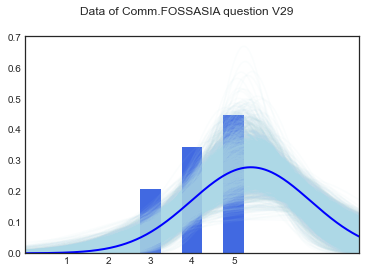

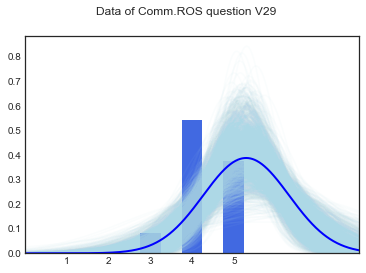

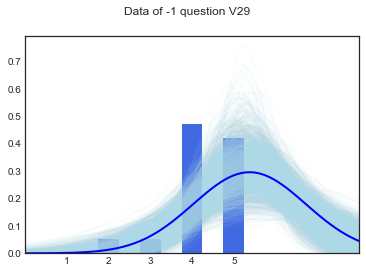

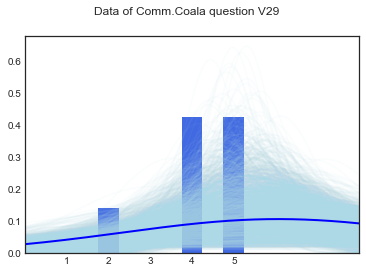

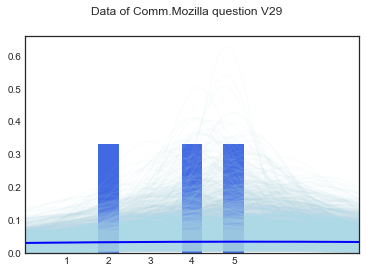

...

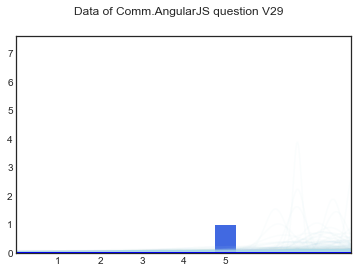

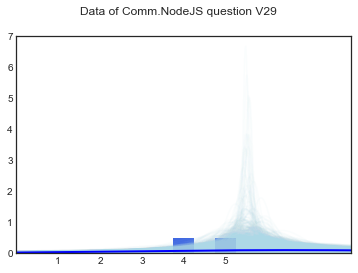

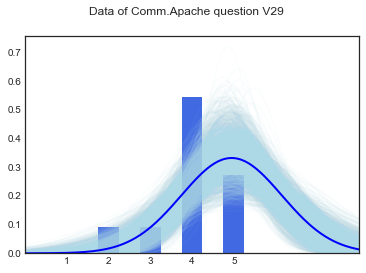

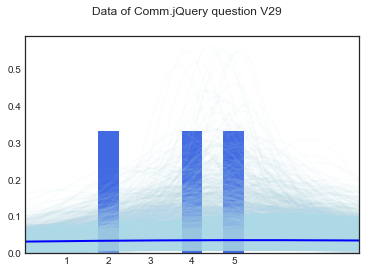

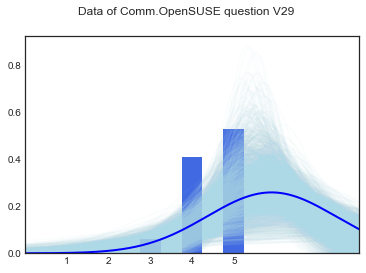

[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

In [17]:
[plot_ppc_normal_density(df2,t_v29,c,'V29') for c in df2.Community.unique()]

### Density plot of mean distributions V29

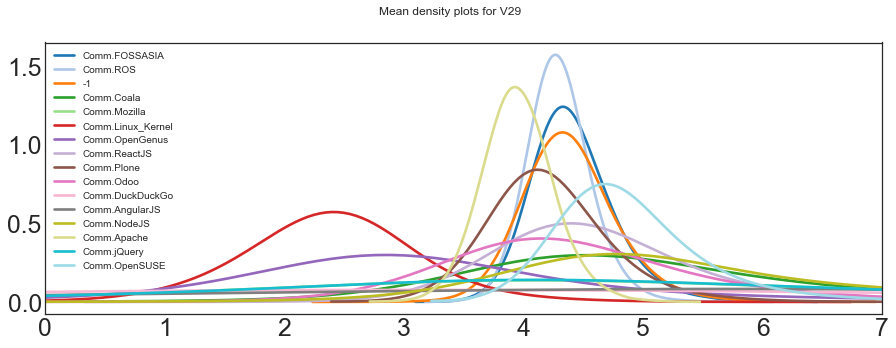

In [15]:
mean_densities(t_v29,'V29')

### Diagnosis

In [19]:
pm.summary(t_v29)

/home/pardo/.local/lib/python3.8/site-packages/arviz/data/io_pymc3.py:85: FutureWarning: Using `from_pymc3` without the model will be deprecated in a future release. Not using the model will return less accurate and less useful results. Make sure you use the model argument or call from_pymc3 within a model context.
  warnings.warn(


,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
theta_missing[0],2.389,0.178,2.052,2.716,0.003,0.002,3488.0,3445.0,3536.0,5517.0,1.0
theta_missing[1],2.953,0.166,2.646,3.270,0.003,0.002,3130.0,3103.0,3132.0,4699.0,1.0
mu[0],4.376,0.385,3.673,5.104,0.003,0.002,14007.0,13414.0,14881.0,11606.0,1.0
mu[1],5.098,4.835,-4.086,14.101,0.041,0.032,13969.0,11376.0,13860.0,13052.0,1.0
mu[2],3.947,0.297,3.410,4.536,0.003,0.002,11426.0,11039.0,11727.0,9830.0,1.0
mu[3],5.061,1.745,2.272,8.712,0.025,0.020,4796.0,3853.0,6897.0,4667.0,1.0
mu[4],3.060,5.026,-6.311,12.648,0.041,0.037,15090.0,9113.0,15115.0,11479.0,1.0
mu[5],4.406,0.342,3.785,5.061,0.004,0.003,8502.0,8164.0,9531.0,8162.0,1.0
mu[6],2.349,0.714,1.031,3.773,0.006,0.005,12375.0,10692.0,12662.0,9342.0,1.0
mu[7],4.409,3.369,-2.103,11.283,0.031,0.028,11736.0,7130.0,12516.0,8714.0,1.0


## Question V30

In [20]:
t_v30=infer('V30')

thresh2:	[1.5 2.5 3.5 4.5]
thresh_obs2:	[1.5 -- -- 4.5]


/home/pardo/.local/lib/python3.8/site-packages/pymc3/model.py:1668: ImputationWarning: Data in theta contains missing values and will be automatically imputed from the sampling distribution.
  warnings.warn(impute_message, ImputationWarning)
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Initializing NUTS failed. Falling back to elementwise auto-assignment.
Multiprocess sampling (4 chains in 4 jobs)
CompoundStep
>Slice: [sigma]
>Slice: [mu]
>Slice: [theta_missing]


Sampling 4 chains for 1_000 tune and 5_000 draw iterations (4_000 + 20_000 draws total) took 2544 seconds.
The number of effective samples is smaller than 10% for some parameters.


### Posterior Predictive Check V30

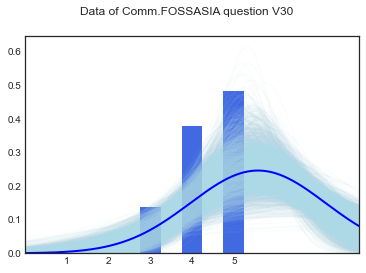

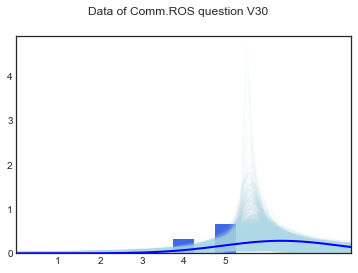

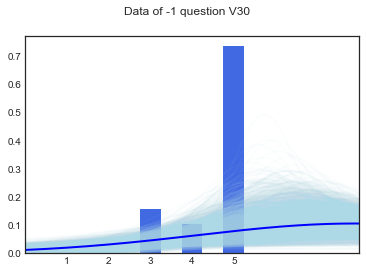

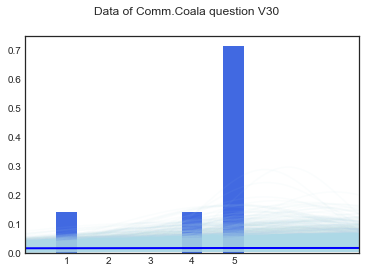

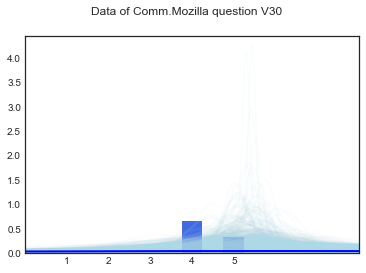

...

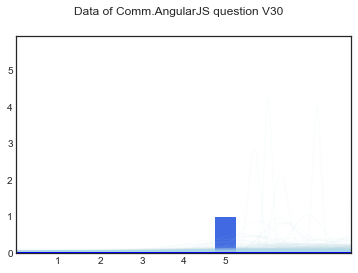

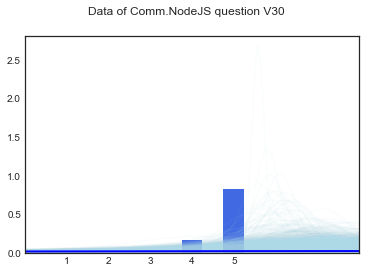

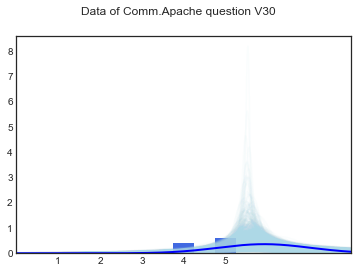

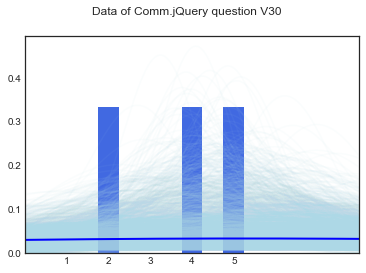

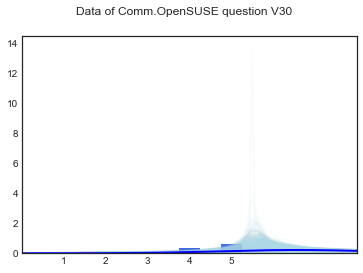

[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

In [21]:
[plot_ppc_normal_density(df2,t_v30,c,'V30') for c in df2.Community.unique()]

### Density plot of mean distributions V30

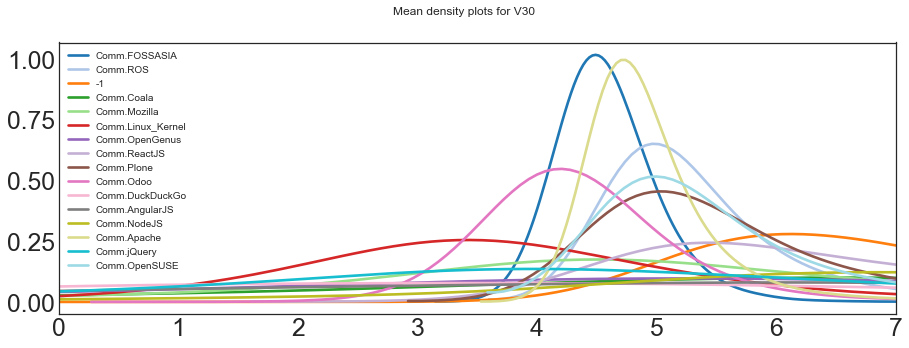

In [23]:
mean_densities(t_v30,'V30')

### Diagnosis V30

In [24]:
pm.summary(t_v30)

/home/pardo/.local/lib/python3.8/site-packages/arviz/data/io_pymc3.py:85: FutureWarning: Using `from_pymc3` without the model will be deprecated in a future release. Not using the model will return less accurate and less useful results. Make sure you use the model argument or call from_pymc3 within a model context.
  warnings.warn(


,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
theta_missing[0],1.787,0.153,1.539,2.067,0.002,0.001,8520.0,8355.0,9432.0,10864.0,1.0
theta_missing[1],2.770,0.219,2.357,3.176,0.003,0.002,5043.0,5025.0,5036.0,8070.0,1.0
mu[0],6.881,1.635,4.397,9.978,0.022,0.016,5522.0,5522.0,5938.0,8655.0,1.0
mu[1],5.150,4.857,-4.285,13.862,0.043,0.033,12603.0,11081.0,12598.0,11970.0,1.0
mu[2],4.922,0.512,4.272,5.868,0.010,0.007,2538.0,2379.0,3914.0,3352.0,1.0
mu[3],6.357,4.133,-1.643,14.266,0.035,0.027,13766.0,11550.0,13696.0,11963.0,1.0
mu[4],3.135,4.951,-6.419,12.108,0.041,0.034,14651.0,10384.0,14668.0,12993.0,1.0
mu[5],4.578,0.411,3.840,5.337,0.005,0.004,7109.0,6569.0,8739.0,5994.0,1.0
mu[6],3.572,1.759,0.343,7.129,0.018,0.015,9685.0,6664.0,11261.0,7428.0,1.0
mu[7],4.855,2.993,-1.303,10.873,0.031,0.027,9304.0,6049.0,10539.0,6984.0,1.0


## Question V31

In [26]:
t_v31=infer('V31')

thresh2:	[1.5 2.5 3.5 4.5]
thresh_obs2:	[1.5 -- -- 4.5]


/home/pardo/.local/lib/python3.8/site-packages/pymc3/model.py:1668: ImputationWarning: Data in theta contains missing values and will be automatically imputed from the sampling distribution.
  warnings.warn(impute_message, ImputationWarning)
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Initializing NUTS failed. Falling back to elementwise auto-assignment.
Multiprocess sampling (4 chains in 4 jobs)
CompoundStep
>Slice: [sigma]
>Slice: [mu]
>Slice: [theta_missing]


Sampling 4 chains for 1_000 tune and 5_000 draw iterations (4_000 + 20_000 draws total) took 2440 seconds.
The number of effective samples is smaller than 25% for some parameters.


### Posterior Predictive Check V31

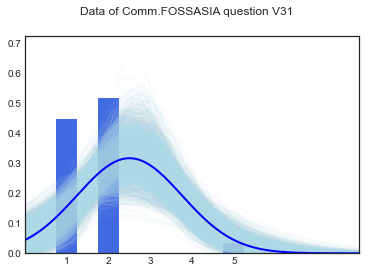

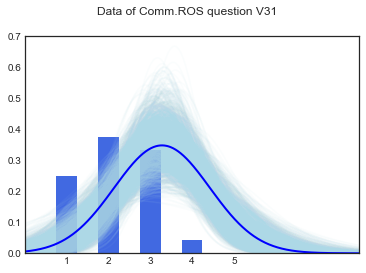

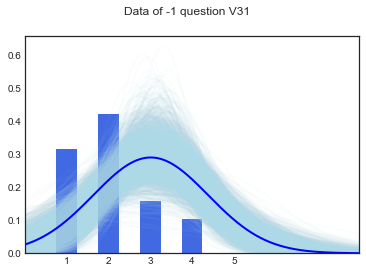

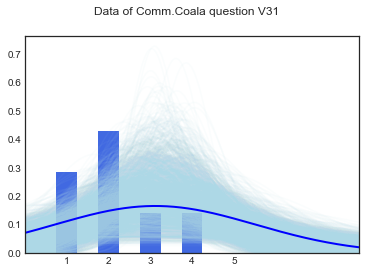

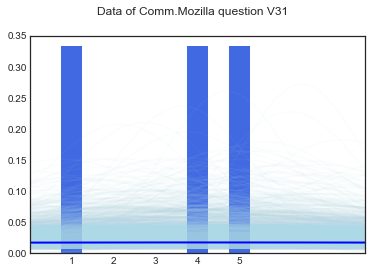

...

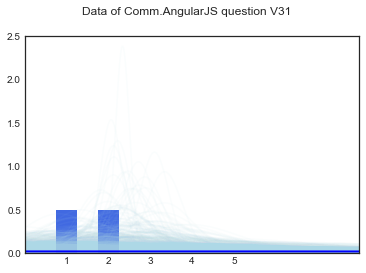

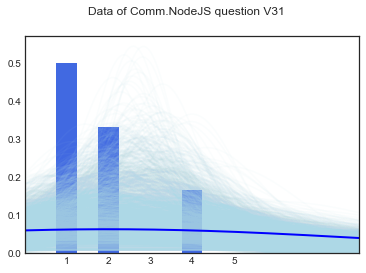

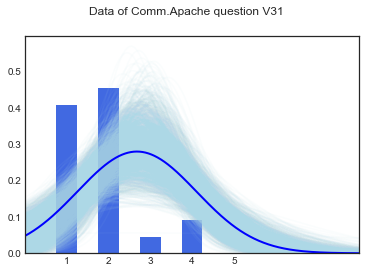

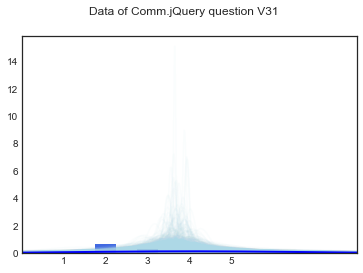

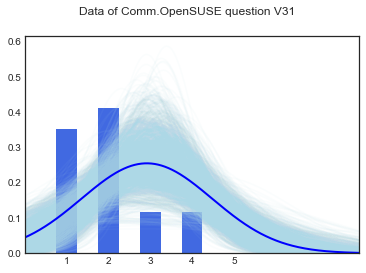

[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

In [27]:
[plot_ppc_normal_density(df2,t_v31,c,'V31') for c in df2.Community.unique()]

### Density plot of mean distributions V31

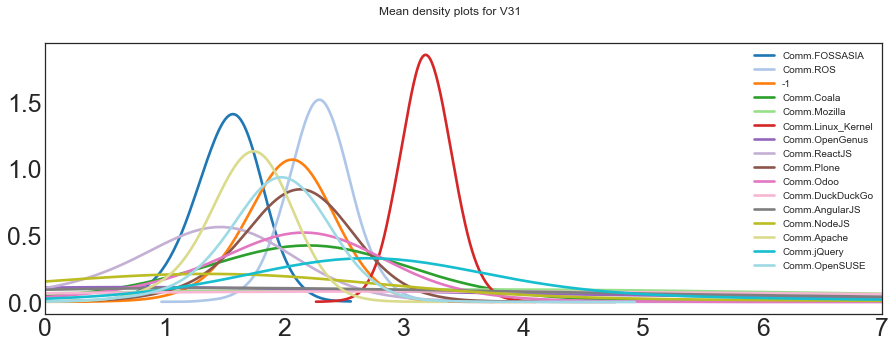

In [28]:
mean_densities(t_v31,'V31')

### Diagnosis V31

In [29]:
pm.summary(t_v31)

/home/pardo/.local/lib/python3.8/site-packages/arviz/data/io_pymc3.py:85: FutureWarning: Using `from_pymc3` without the model will be deprecated in a future release. Not using the model will return less accurate and less useful results. Make sure you use the model argument or call from_pymc3 within a model context.
  warnings.warn(


,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
theta_missing[0],2.832,0.137,2.571,3.087,0.002,0.002,4060.0,4060.0,4056.0,7255.0,1.0
theta_missing[1],3.666,0.157,3.364,3.952,0.003,0.002,3746.0,3746.0,3789.0,6366.0,1.0
mu[0],2.015,0.365,1.311,2.676,0.003,0.002,16654.0,16654.0,16976.0,12826.0,1.0
mu[1],1.692,4.215,-6.349,9.846,0.035,0.033,14439.0,8109.0,14606.0,11237.0,1.0
mu[2],1.685,0.359,0.991,2.349,0.003,0.002,12056.0,12044.0,12223.0,11822.0,1.0
mu[3],2.120,1.025,0.220,3.963,0.011,0.011,8436.0,4657.0,11118.0,6511.0,1.0
mu[4],3.078,4.959,-6.275,12.321,0.042,0.035,13637.0,9808.0,13634.0,11836.0,1.0
mu[5],1.507,0.286,0.973,2.043,0.003,0.002,11599.0,11599.0,11859.0,11815.0,1.0
mu[6],3.183,0.215,2.766,3.576,0.003,0.002,5762.0,5712.0,5772.0,8090.0,1.0
mu[7],3.276,4.404,-5.420,11.377,0.036,0.032,14609.0,9679.0,14671.0,11795.0,1.0


## Question V32

## Question V33

In this section we explore the results of analyzing question _V33: "I don’t consider a pull
request/patch, unless I trust the contributor"_

### Posterior Predictive Check V33

First we check whether our analysis correctly models the data. To this end, we plot a posterior predictive check. Concretely, we use a bar plot to show the row data, and we overlay the normal distribution obtained from the inference. The light blue lines are draws from the chain, the thicker blue line is the mean.

In [25]:
[plot_ppc_normal_density(df2,t,c,'V33') for c in df2.Community.unique()]

NameError: name 't' is not defined

### Density plot of mean distributions

Here we show the density plot of the posterior means for each community. This plot allows us to determine the governance style of a community. See Table 4 in accompanying paper.

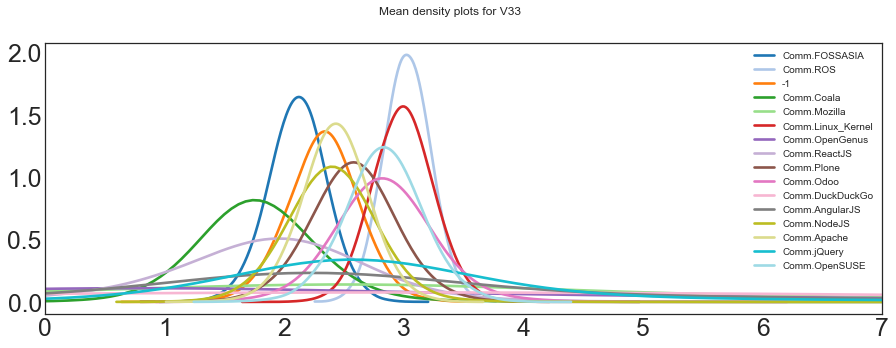

In [314]:
mean_densities(t,'V33')

### Posterior Diagnosis

Below we look at some metrics to determine the quality of our analysis. The ESS and $\hat{R}$ (`r_hat`) values indicate good accuracy.

In [196]:
pm.summary(t)

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
theta_missing[0],2.686,0.122,2.464,2.921,0.002,0.002,3144.0,3144.0,3143.0,6126.0,1.0
theta_missing[1],3.500,0.141,3.237,3.763,0.003,0.002,3112.0,3112.0,3114.0,6132.0,1.0
mu[0],2.318,0.297,1.750,2.864,0.002,0.002,16336.0,16102.0,16311.0,14231.0,1.0
mu[1],2.563,2.487,-2.069,8.362,0.025,0.025,9952.0,4811.0,11684.0,6688.0,1.0
mu[2],2.421,0.279,1.888,2.941,0.003,0.002,11239.0,10767.0,11142.0,10852.0,1.0
mu[3],1.762,0.467,1.010,2.541,0.007,0.006,3882.0,2647.0,8323.0,4769.0,1.0
mu[4],3.020,5.034,-6.612,12.280,0.042,0.037,14542.0,9067.0,14617.0,11702.0,1.0
mu[5],2.103,0.241,1.635,2.548,0.002,0.002,10534.0,10223.0,10472.0,10459.0,1.0
mu[6],2.988,0.250,2.529,3.461,0.003,0.002,7177.0,7032.0,7229.0,9098.0,1.0
mu[7],2.410,3.465,-4.313,9.490,0.032,0.032,11505.0,6037.0,12448.0,8636.0,1.0
